#Blood Cells Classification for Cancer

This project aims to develop a predictive model for detecting Acute Lymphoblastic Leukemia (ALL) from blood cell images.

## Set up the environment and dataset

In [ ]:
# Install all needed modules
!pip install ImageHash
!pip install opencv-python
!pip install tensorflow
!pip install imagehash Pillow
!pip install scikit-learn

In [ ]:
# Load modules
import os
import time
import shutil
import pathlib
import itertools
from PIL import Image
import imagehash

import cv2
import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('darkgrid')
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, precision_score, recall_score, f1_score, accuracy_score, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.svm import SVC

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras import regularizers
from collections import defaultdict

import warnings
warnings.filterwarnings("ignore")

print ('modules loaded')

modules loaded


In [ ]:
# Upload Kaggle API key
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"jouchihuang","key":"f764f23e82c57f072a05a4e3b72eb84f"}'}

In [ ]:
# Create a folder for API key
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d mohammadamireshraghi/blood-cell-cancer-all-4class

Dataset URL: https://www.kaggle.com/datasets/mohammadamireshraghi/blood-cell-cancer-all-4class
License(s): Attribution-NonCommercial 4.0 International (CC BY-NC 4.0)
100% 1.68G/1.68G [01:16<00:00, 23.8MB/s]
100% 1.68G/1.68G [01:16<00:00, 23.6MB/s]


In [ ]:
# Unzip the datasetn
!unzip blood-cell-cancer-all-4class.zip -d dataset/

Archive:  blood-cell-cancer-all-4class.zip
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (1).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (10).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (11).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (12).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (13).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (14).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (15).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (16).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (17).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (18).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (19).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (2).jpg  
  inflating: dataset/Blood cell Cancer [ALL]/Benign/Sap_013 (20).jpg  
  inflating: dataset/Blood cell Canc

In [ ]:
data_path = "dataset/Blood cell Cancer [ALL]"

images = []
labels = []

for subfolder in os.listdir(data_path):

    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue

    for image_filename in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_filename)
        images.append(image_path)

        labels.append(subfolder)

data = pd.DataFrame({'image': images, 'label': labels})

In [ ]:
data.head()

,image,label
0,dataset/Blood cell Cancer [ALL]/[Malignant] Pr...,[Malignant] Pro-B
1,dataset/Blood cell Cancer [ALL]/[Malignant] Pr...,[Malignant] Pro-B
2,dataset/Blood cell Cancer [ALL]/[Malignant] Pr...,[Malignant] Pro-B
3,dataset/Blood cell Cancer [ALL]/[Malignant] Pr...,[Malignant] Pro-B
4,dataset/Blood cell Cancer [ALL]/[Malignant] Pr...,[Malignant] Pro-B


In [ ]:
data.tail()

,image,label
3237,dataset/Blood cell Cancer [ALL]/[Malignant] ea...,[Malignant] early Pre-B
3238,dataset/Blood cell Cancer [ALL]/[Malignant] ea...,[Malignant] early Pre-B
3239,dataset/Blood cell Cancer [ALL]/[Malignant] ea...,[Malignant] early Pre-B
3240,dataset/Blood cell Cancer [ALL]/[Malignant] ea...,[Malignant] early Pre-B
3241,dataset/Blood cell Cancer [ALL]/[Malignant] ea...,[Malignant] early Pre-B


In [ ]:
# Get unique class labels, ensuring we have all 4 classes
class_labels = sorted(os.listdir(data_path))
print("Classes and their corresponding indices:")
for idx, label in enumerate(class_labels):
    print(f"Class {idx}: {label}")

Classes and their corresponding indices:
Class 0: Benign
Class 1: [Malignant] Pre-B
Class 2: [Malignant] Pro-B
Class 3: [Malignant] early Pre-B


**Print out the number of each class to see if there's data imbalance.**

In [ ]:
# Print the number of samples in each class
class_counts = data['label'].value_counts()
print(class_counts)

label
[Malignant] early Pre-B    979
[Malignant] Pre-B          955
[Malignant] Pro-B          796
Benign                     512
Name: count, dtype: int64


## Apply Hash Algorithm to speed up + Data preprocessing

This experiment investigates the effectiveness of hash algorithms in identifying and removing duplicate or similar images, with the goal of enhancing prediction efficiency.

In [ ]:
# Use a perceptual hash to generate a unique hash for each image
def get_image_hash(image_path):
    try:
        img = Image.open(image_path)
        return str(imagehash.phash(img))
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return None

In [ ]:
# Generate hash and integrate hash to data frame
data_path = "dataset/Blood cell Cancer [ALL]"
images = []
labels = []
hashes = []

for subfolder in os.listdir(data_path):
    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue

    for image_filename in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_filename)
        img_hash = get_image_hash(image_path)

        if img_hash:
            images.append(image_path)
            labels.append(subfolder)
            hashes.append(img_hash)

# Create new DataFrame with image hashes
data = pd.DataFrame({'image': images, 'label': labels, 'hash': hashes})

print(data.head())

                                               image              label  \
0  dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  [Malignant] Pro-B   
1  dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  [Malignant] Pro-B   
2  dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  [Malignant] Pro-B   
3  dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  [Malignant] Pro-B   
4  dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  [Malignant] Pro-B   

               hash  
0  811e330fee0fe662  
1  81e15a7310de677c  
2  d4454cdc40fa73bc  
3  84f044fcfa437b32  
4  d75217eaa98d5286  


**Remove duplicate images based on hash values.** Additionally, validate whether the algorithm is recognizing and distinguishing identical images correctly.

In [ ]:
# Print out all the images that has same hash values
duplicates = data[data.duplicated(subset=['hash'], keep=False)]
print("Duplicate images found:")
print(duplicates[['image', 'hash']])

Duplicate images found:
                                                  image              hash
2     dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  d4454cdc40fa73bc
15    dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  d25b70485b8b13af
22    dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  95cf4458d4f204f7
32    dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  c45b45d430760fed
40    dataset/Blood cell Cancer [ALL]/[Malignant] Pr...  d45853be9d0d4999
...                                                 ...               ...
3069  dataset/Blood cell Cancer [ALL]/[Malignant] ea...  c5551695927b22fa
3092  dataset/Blood cell Cancer [ALL]/[Malignant] ea...  a58b52c3593ee1a6
3125  dataset/Blood cell Cancer [ALL]/[Malignant] ea...  c9c23534cf7912ba
3137  dataset/Blood cell Cancer [ALL]/[Malignant] ea...  d295196624dbdd64
3237  dataset/Blood cell Cancer [ALL]/[Malignant] ea...  e88d635b856e29c9

[132 rows x 2 columns]


**Group images with the same hash value to systematically visualize.**

In [ ]:
hash_groups = defaultdict(list)

# Group images by their hash values
for _, row in duplicates.iterrows():
    hash_groups[row['hash']].append(row['image'])

# Print images with the same hash
for h, img_list in hash_groups.items():
    print(f"\nImages with hash {h}:")
    for img in img_list:
        print(f"  - {img}")


Images with hash d4454cdc40fa73bc:
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_182.jpg
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_183.jpg

Images with hash d25b70485b8b13af:
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_095.jpg
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_095 - Copy.jpg

Images with hash 95cf4458d4f204f7:
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_088 - Copy.jpg
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_088.jpg

Images with hash c45b45d430760fed:
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_118.jpg
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_118 - Copy.jpg

Images with hash d45853be9d0d4999:
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_067.jpg
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_067 - Copy.jpg

Images with hash d11c11d63eb8bc36:
  - dataset/Blood cell Cancer [ALL]/[Malignant] Pro-B/Snap_070.jpg
  - dataset/Blood c

**Print out the images have same hash values to see if it's actually duplicate images.**

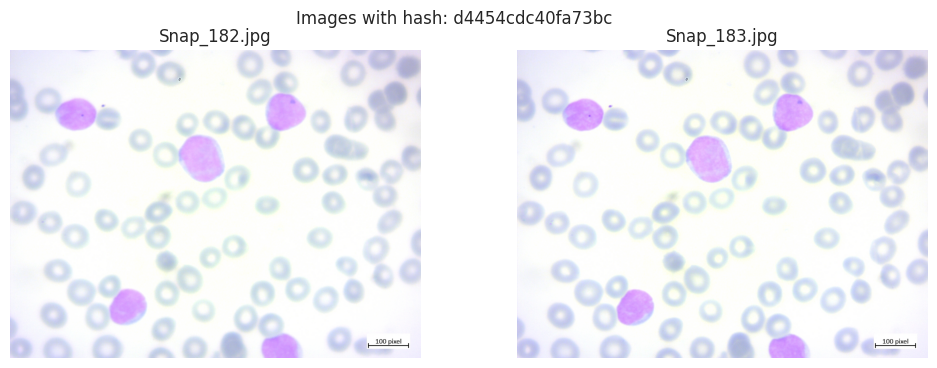

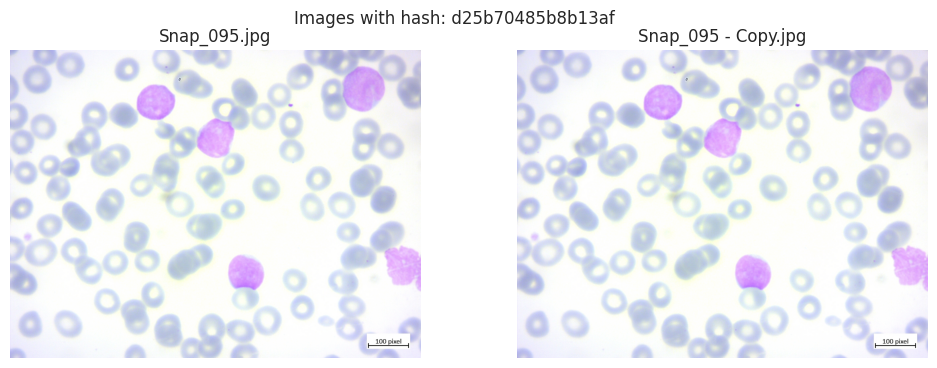

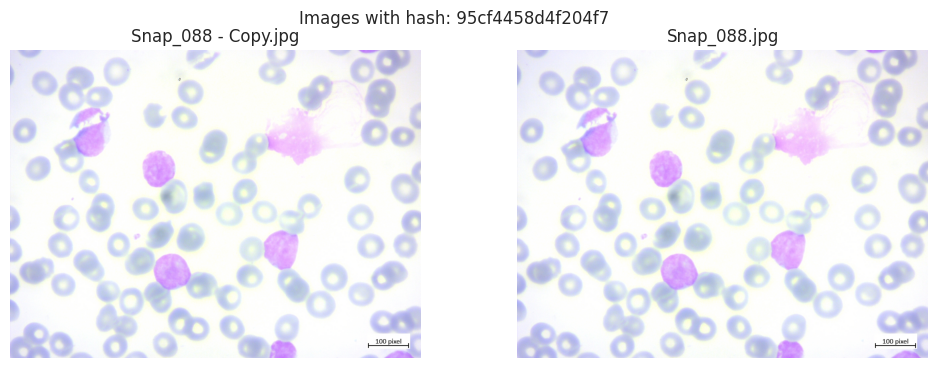

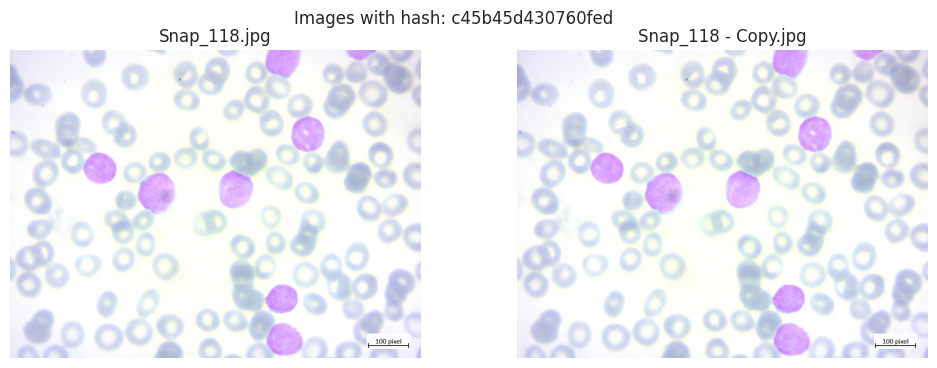

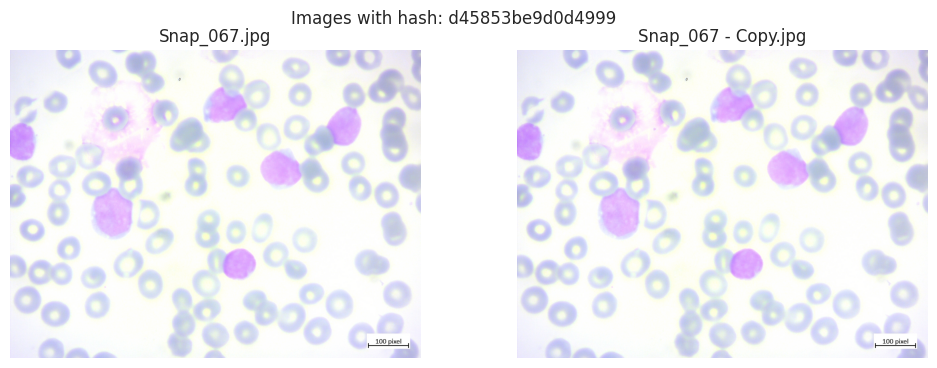

...

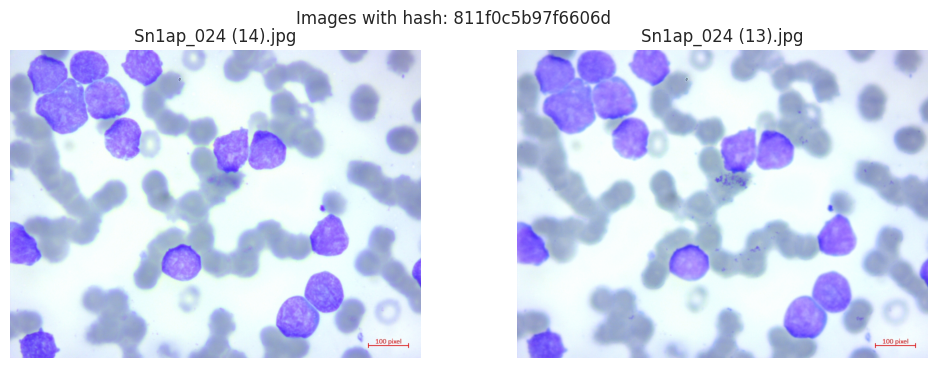

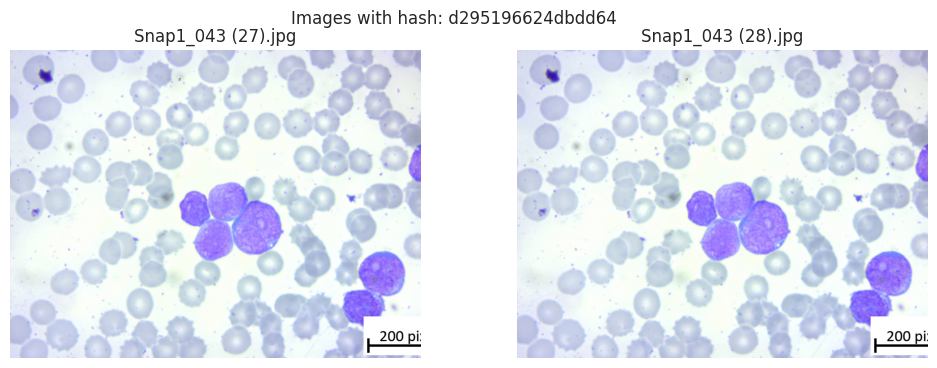

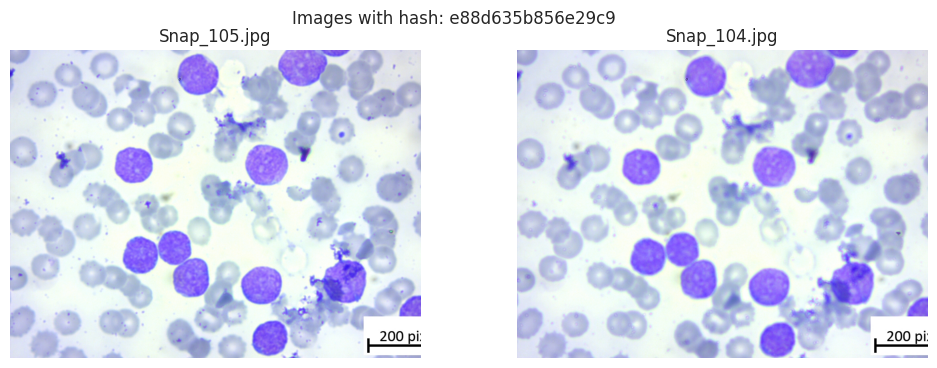

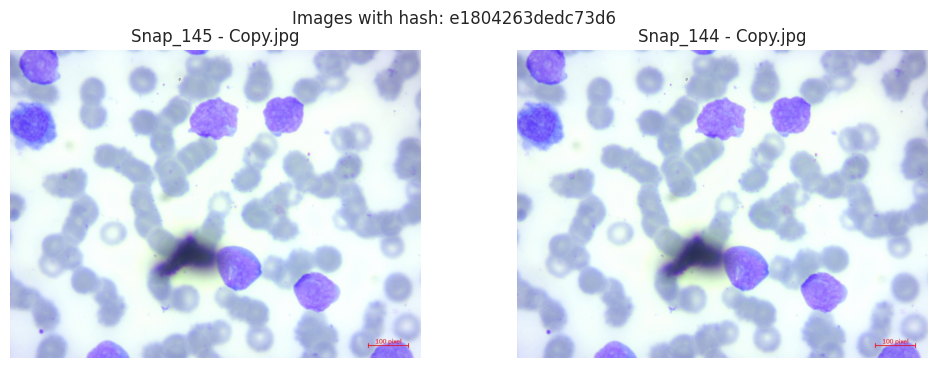

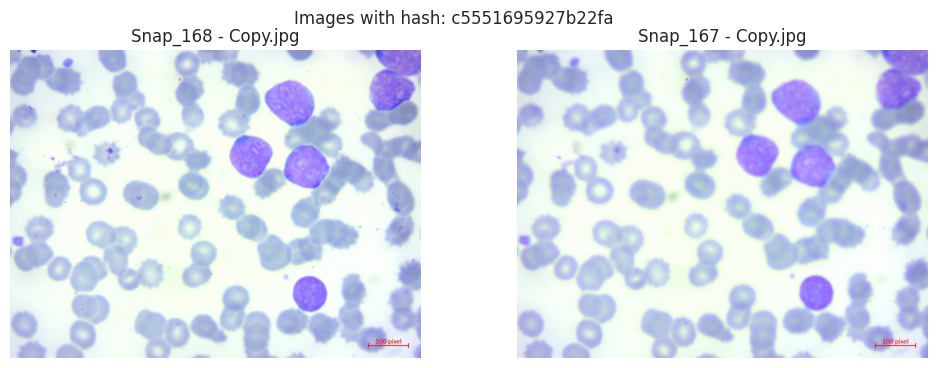

In [ ]:
def show_duplicate_images(duplicate_hashes):
    for h, img_list in hash_groups.items():
        fig, axes = plt.subplots(1, len(img_list), figsize=(12, 4))
        fig.suptitle(f"Images with hash: {h}")

        for ax, img_path in zip(axes, img_list):
            img = cv2.imread(img_path)[:, :, ::-1]  # Convert BGR to RGB
            ax.imshow(img)
            ax.set_title(img_path.split('/')[-1])
            ax.axis('off')

        plt.show()

show_duplicate_images(duplicates)

**Remove the duplicate images to improve the prediction and traning efficiency.**

In [ ]:
# Drop the duplicate images
# Print out the row difference to see how many data we dropped
print("Total rows before removing duplicates:", len(data))

data.drop_duplicates(subset=['hash'], inplace=True)

print("Total rows after removing duplicates:", len(data))

Total rows before removing duplicates: 3242
Total rows after removing duplicates: 3176


## Split the data

In [ ]:
strat = data['label']
train_df, dummy_df = train_test_split(data,  train_size= 0.85, shuffle= True, random_state= 123, stratify= strat)

strat = dummy_df['label']
valid_df, test_df = train_test_split(dummy_df,  train_size= 0.5, shuffle= True, random_state= 123, stratify= strat)

In [ ]:
print("Training set shape:", train_df.shape)
print("Validation set shape:", valid_df.shape)
print("Test set shape:", test_df.shape)

Training set shape: (2699, 3)
Validation set shape: (238, 3)
Test set shape: (239, 3)


In [ ]:
batch_size = 32
img_size = (150, 150)
channels = 3
img_shape = (img_size[0], img_size[1], channels)

tr_gen = ImageDataGenerator()
ts_gen = ImageDataGenerator()

train_gen = tr_gen.flow_from_dataframe(train_df, x_col='image', y_col='label', target_size=img_size, class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

valid_gen = ts_gen.flow_from_dataframe(valid_df, x_col='image', y_col='label', target_size=img_size, class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

test_gen = ts_gen.flow_from_dataframe(test_df, x_col='image', y_col='label', target_size=img_size, class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=batch_size)

Found 2699 validated image filenames belonging to 4 classes.
Found 238 validated image filenames belonging to 4 classes.
Found 239 validated image filenames belonging to 4 classes.


## Normalize the pixels in training images

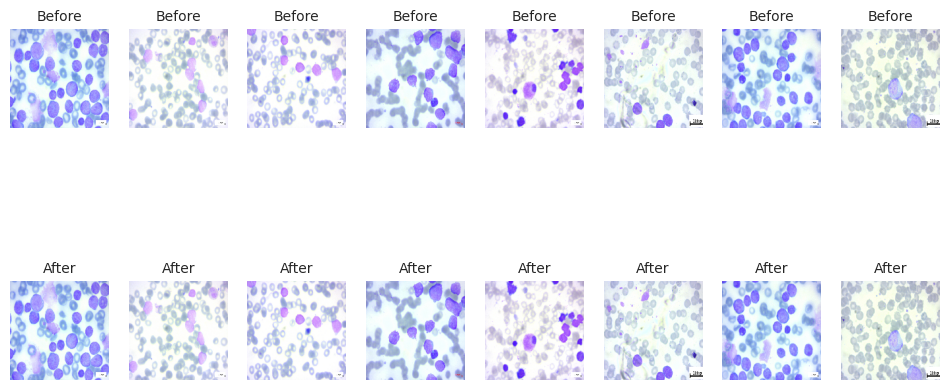

In [ ]:
# Show the comparison between before and after normalizing images
g_dict = train_gen.class_indices
classes = list(g_dict.keys())
images, labels = next(train_gen)

plt.figure(figsize=(12, 6))

for i in range(8):
    plt.subplot(2, 8, i + 1)
    plt.imshow(images[i].astype('uint8'))  # Original (0-255)
    plt.title("Before", fontsize=10)
    plt.axis('off')

    plt.subplot(2, 8, i + 9)
    plt.imshow(images[i] / 255)  # Normalized (0-1)
    plt.title("After", fontsize=10)
    plt.axis('off')

plt.show()

Visually, there is no noticeable difference between the images before and after normalization. However, the final model evaluations differ depending on whether hashing was used, as shown below.

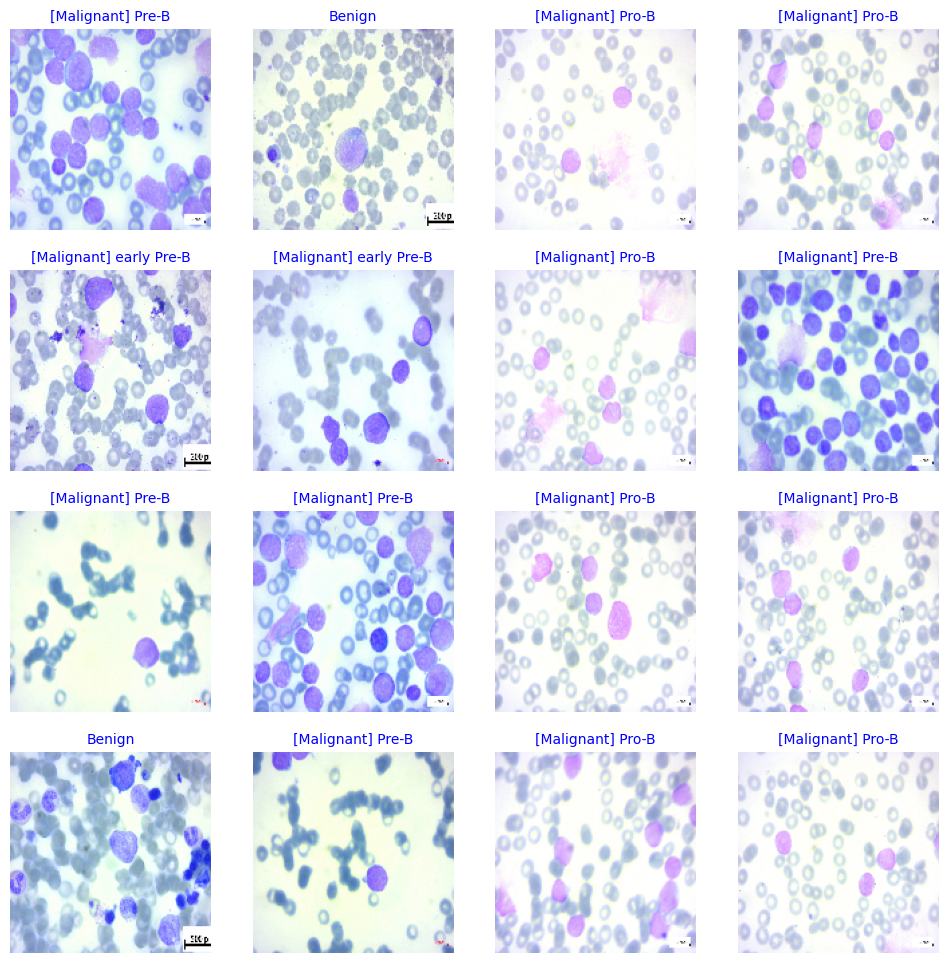

In [ ]:
g_dict = train_gen.class_indices
classes = list(g_dict.keys())
images, labels = next(train_gen)

plt.figure(figsize= (12, 12))

for i in range(16):
    plt.subplot(4, 4, i + 1)
    image = images[i] / 255 # Normalize pixels to 0-1 range
    plt.imshow(image)
    index = np.argmax(labels[i])
    class_name = classes[index]
    plt.title(class_name, color= 'blue', fontsize= 10)
    plt.axis('off')
plt.show()

##Squeeze and Excitation in CNN

This technique is aimed at enhancing important features while suppressing less useful ones, **allowing the network to focus on the most relevant information during training.**

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator

Squeeze: This step **compresses the spatial information of each feature map into a single descriptor**, using global average pooling.

Excitation: Excite the feature maps by learning **a set of channel-wise weights** that will be used to scale the channels.

Recalibration: The recalibrated feature map is obtained by **multiplying each original feature map by its corresponding weight** from the excitation step.

In [ ]:
def squeeze_excite_block(input, ratio=16):
    # Get number of channels in the input
    channel_axis = -1
    channels = input.shape[channel_axis]

    # Squeeze: Global Average Pooling
    se = layers.GlobalAveragePooling2D()(input)
    se = layers.Reshape((1, 1, channels))(se)

    # Excitation: Fully Connected layer with ReLU and Sigmoid activations
    se = layers.Dense(channels // ratio, activation='relu')(se)
    se = layers.Dense(channels, activation='sigmoid')(se)

    # Scale the input by the output of the SE block
    se = layers.Multiply()([input, se])
    return se

In [ ]:
def create_senet_model(input_shape, num_classes):
    input = layers.Input(shape=input_shape)

    # Initial Convolution Layer
    x = layers.Conv2D(32, (3, 3), padding='same', activation='relu')(input)
    x = layers.MaxPooling2D((2, 2))(x)

    # SENet Block 1
    x = squeeze_excite_block(x)

    # More Convolution Layers
    x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = layers.MaxPooling2D((2, 2))(x)

    # SENet Block 2
    x = squeeze_excite_block(x)

    # Global Average Pooling for final feature reduction
    x = layers.GlobalAveragePooling2D()(x)

    # Fully Connected Layer
    x = layers.Dense(128, activation='relu')(x)

    # Output Layer
    output = layers.Dense(num_classes, activation='softmax')(x)

    # Create the Model
    model = models.Model(inputs=input, outputs=output)

    return model

In [ ]:
model = create_senet_model(input_shape=(150, 150, 3), num_classes=len(train_gen.class_indices))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print the model summary to confirm the architecture
model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 150, 150, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 150, 150, 32)   │            896 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_4           │ (None, 75, 75, 32)     │              0 │ conv2d_4[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 32)             │              0 │ max_pooling2d_4[0][0]  │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_4 (Reshape)       │ (None, 1, 1, 32)       │              0 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_12 (Dense)          │ (None, 1, 1, 2)        │             66 │ reshape_4[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_13 (Dense)          │ (None, 1, 1, 32)       │             96 │ dense_12[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply_4 (Multiply)     │ (None, 75, 75, 32)     │              0 │ max_pooling2d_4[0][0], │
│                           │                        │                │ dense_13[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 75, 75, 64)     │         18,496 │ multiply_4[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_5           │ (None, 37, 37, 64)     │              0 │ conv2d_5[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 64)             │              0 │ max_pooling2d_5[0][0]  │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_5 (Reshape)       │ (None, 1, 1, 64)       │              0 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_14 (Dense)          │ (None, 1, 1, 4)        │            260 │ reshape_5[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_15 (Dense)          │ (None, 1, 1, 64)       │            320 │ dense_14[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply_5 (Multiply)     │ (None, 37, 37, 64)     │              0 │ max_pooling2d_5[0][0], │
│                           │                        │                │ dense_15[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 64)             │              0 │ multiply_5[0][0]       │
│ (GlobalAveragePooling

 Total params: 28,970 (113.16 KB)

 Trainable params: 28,970 (113.16 KB)

 Non-trainable params: 0 (0.00 B)

Train the model while also tracking the duration of the training process to evaluate whether the hash algorithm contributes to faster performance.

In [ ]:
import time

# Start time
start_time = time.time()

# Train the model
history = model.fit(
    train_gen,
    steps_per_epoch=train_gen.samples // batch_size,
    epochs=10,
    validation_data=valid_gen,
    validation_steps=valid_gen.samples // batch_size
)

# End time
end_time = time.time()

# Calculate the training duration
training_duration = end_time - start_time
print(f"Training took {training_duration:.2f} seconds.")

Epoch 1/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 38s 398ms/step - accuracy: 0.4574 - loss: 2.5867 - val_accuracy: 0.6116 - val_loss: 0.7603
Epoch 2/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - accuracy: 0.5625 - loss: 0.9456 - val_accuracy: 0.6027 - val_loss: 0.7291
Epoch 3/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 30s 362ms/step - accuracy: 0.7310 - loss: 0.7255 - val_accuracy: 0.8036 - val_loss: 0.5947
Epoch 4/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - accuracy: 0.8750 - loss: 0.4388 - val_accuracy: 0.8036 - val_loss: 0.5983
Epoch 5/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 31s 366ms/step - accuracy: 0.7706 - loss: 0.6054 - val_accuracy: 0.8661 - val_loss: 0.4423
Epoch 6/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - accuracy: 0.9688 - loss: 0.3277 - val_accuracy: 0.7545 - val_loss: 0.5396
Epoch 7/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 31s 363ms/step - accuracy: 0.8230 - loss: 0.4421 - val_accuracy: 0.8259 - val_loss: 0.3839
Epoch 8/10
84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.8438 - loss: 0.2904 - val_accuracy: 0.

In [ ]:
test_loss, test_acc = model.evaluate(test_gen, steps=test_gen.samples // batch_size)
print(f"Test accuracy: {test_acc}")

7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 365ms/step - accuracy: 0.8518 - loss: 0.4009
Test accuracy: 0.84375


In [ ]:
model.save('senet_blood_cell_model.h5')

In [ ]:
# Get predictions for the test set
predictions = model.predict(test_gen, steps=test_gen.samples // batch_size)

7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 296ms/step


In [ ]:
# Get the predicted class labels
predicted_classes = np.argmax(predictions, axis=1)

# Get the true class labels from the test generator
true_classes = test_gen.classes

In [ ]:
true_classes = test_gen.classes
print(len(true_classes))

239


In [ ]:
predictions = model.predict(test_gen)
predicted_classes = np.argmax(predictions, axis=1)
print(len(predicted_classes))

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 425ms/step
239


In [ ]:
# Calculate Accuracy
accuracy = accuracy_score(true_classes, predicted_classes)
print(f"Accuracy: {accuracy:.4f}")

# Calculate Precision
precision = precision_score(true_classes, predicted_classes, average='weighted')  # weighted averages for multi-class classification
print(f"Precision: {precision:.4f}")

# Calculate Recall
recall = recall_score(true_classes, predicted_classes, average='weighted')
print(f"Recall: {recall:.4f}")

# Calculate F1-Score
f1 = f1_score(true_classes, predicted_classes, average='weighted')
print(f"F1-Score: {f1:.4f}")

Accuracy: 0.8452
Precision: 0.8523
Recall: 0.8452
F1-Score: 0.8323


In [ ]:
# Confusion Matrix tovisualize classification performance)
conf_matrix = confusion_matrix(true_classes, predicted_classes)
print("Confusion Matrix:")
print(conf_matrix)

Confusion Matrix:
[[15  2  5 16]
 [ 0 65  2  5]
 [ 0  0 56  0]
 [ 3  0  4 66]]


Takeaways:
1. Pre-B, Pro-B and early Pre-B have relatively high accuracy, with most predictions landing in the correct category.
2. **Benign has a high misclassification rate to early Pre-B, indicating potential confusion between these two classes.**
3. The diagonal values indicate correct predictions for each class. **Correct predictions are still majority cases.**

## Squeeze and Excitation in CNN Without Hash Algorithm

In [ ]:
# Reload the data just in case hash is not applied
data_path = "dataset/Blood cell Cancer [ALL]"

images = []
labels = []

for subfolder in os.listdir(data_path):

    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue

    for image_filename in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_filename)
        images.append(image_path)

        labels.append(subfolder)

data = pd.DataFrame({'image': images, 'label': labels})
print(len(data)) # Match the original data length = 3242

3242


In [ ]:
strat = data['label']
train_df, dummy_df = train_test_split(data,  train_size= 0.85, shuffle= True, random_state= 123, stratify= strat)

strat = dummy_df['label']
valid_df, test_df = train_test_split(dummy_df,  train_size= 0.5, shuffle= True, random_state= 123, stratify= strat)

In [ ]:
print("Training set shape:", train_df.shape)
print("Validation set shape:", valid_df.shape)
print("Test set shape:", test_df.shape)

Training set shape: (2755, 2)
Validation set shape: (243, 2)
Test set shape: (244, 2)


In [ ]:
batch_size = 32
img_size = (150, 150)
channels = 3
img_shape = (img_size[0], img_size[1], channels)

tr_gen = ImageDataGenerator()
ts_gen = ImageDataGenerator()

train_gen = tr_gen.flow_from_dataframe(train_df, x_col='image', y_col='label', target_size=img_size, class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

valid_gen = ts_gen.flow_from_dataframe(valid_df, x_col='image', y_col='label', target_size=img_size, class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

test_gen = ts_gen.flow_from_dataframe(test_df, x_col='image', y_col='label', target_size=img_size, class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=batch_size)

Found 2755 validated image filenames belonging to 4 classes.
Found 243 validated image filenames belonging to 4 classes.
Found 244 validated image filenames belonging to 4 classes.


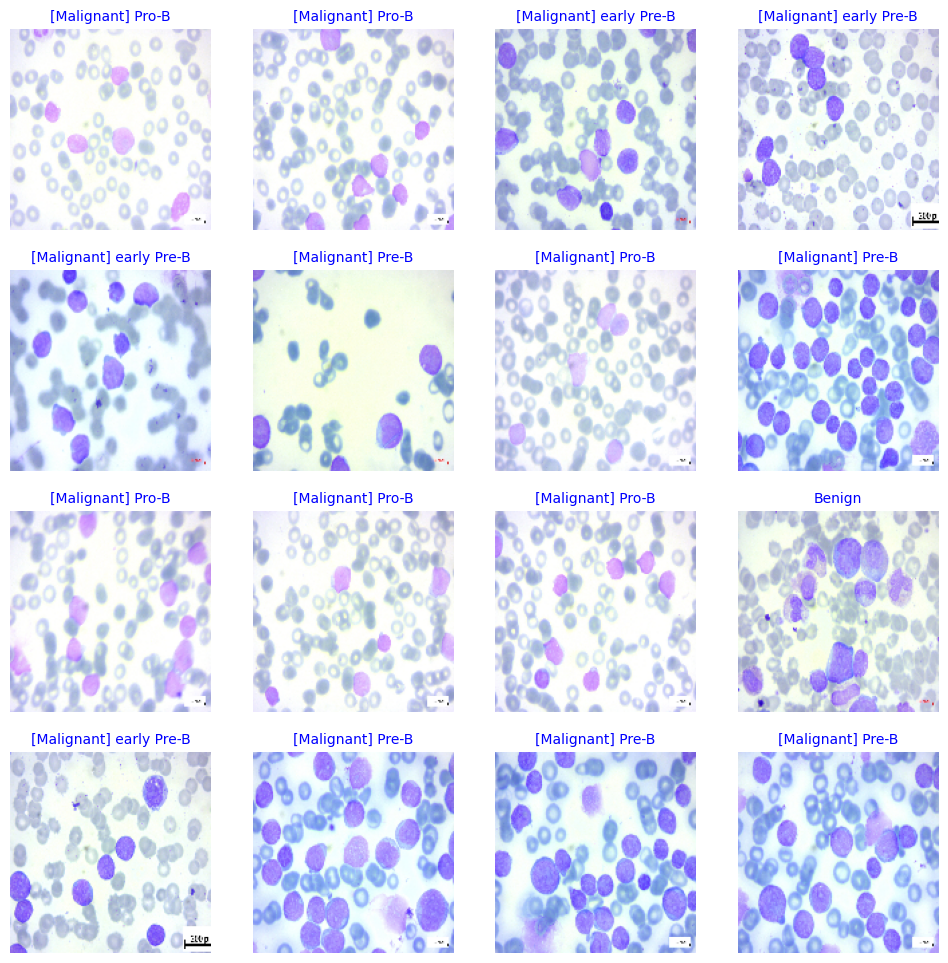

In [ ]:
g_dict = train_gen.class_indices
classes = list(g_dict.keys())
images, labels = next(train_gen)

plt.figure(figsize= (12, 12))

for i in range(16):
    plt.subplot(4, 4, i + 1)
    image = images[i] / 255 # Normalize pixels to 0-1 range
    plt.imshow(image)
    index = np.argmax(labels[i])
    class_name = classes[index]
    plt.title(class_name, color= 'blue', fontsize= 10)
    plt.axis('off')
plt.show()

In [ ]:
model = create_senet_model(input_shape=(150, 150, 3), num_classes=len(train_gen.class_indices))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print the model summary to confirm the architecture
model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 150, 150, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_6 (Conv2D)         │ (None, 150, 150, 32)   │            896 │ input_layer_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_6           │ (None, 75, 75, 32)     │              0 │ conv2d_6[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 32)             │              0 │ max_pooling2d_6[0][0]  │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_6 (Reshape)       │ (None, 1, 1, 32)       │              0 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_18 (Dense)          │ (None, 1, 1, 2)        │             66 │ reshape_6[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_19 (Dense)          │ (None, 1, 1, 32)       │             96 │ dense_18[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply_6 (Multiply)     │ (None, 75, 75, 32)     │              0 │ max_pooling2d_6[0][0], │
│                           │                        │                │ dense_19[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_7 (Conv2D)         │ (None, 75, 75, 64)     │         18,496 │ multiply_6[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_7           │ (None, 37, 37, 64)     │              0 │ conv2d_7[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 64)             │              0 │ max_pooling2d_7[0][0]  │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_7 (Reshape)       │ (None, 1, 1, 64)       │              0 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_20 (Dense)          │ (None, 1, 1, 4)        │            260 │ reshape_7[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_21 (Dense)          │ (None, 1, 1, 64)       │            320 │ dense_20[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply_7 (Multiply)     │ (None, 37, 37, 64)     │              0 │ max_pooling2d_7[0][0], │
│                           │                        │                │ dense_21[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 64)             │              0 │ multiply_7[0][0]       │
│ (GlobalAveragePooling

 Total params: 28,970 (113.16 KB)

 Trainable params: 28,970 (113.16 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
import time

# Start time
start_time = time.time()

# Train the model
history = model.fit(
    train_gen,
    steps_per_epoch=train_gen.samples // batch_size,
    epochs=10,
    validation_data=valid_gen,
    validation_steps=valid_gen.samples // batch_size
)

# End time
end_time = time.time()

# Calculate the training duration
training_duration = end_time - start_time
print(f"Training took {training_duration:.2f} seconds.")

Epoch 1/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.3620 - loss: 2.5406 - val_accuracy: 0.5759 - val_loss: 0.9875
Epoch 2/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - accuracy: 0.4688 - loss: 1.2092 - val_accuracy: 0.5893 - val_loss: 0.9156
Epoch 3/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 31s 357ms/step - accuracy: 0.7057 - loss: 0.7591 - val_accuracy: 0.8036 - val_loss: 0.4978
Epoch 4/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - accuracy: 0.8125 - loss: 0.4971 - val_accuracy: 0.8393 - val_loss: 0.4746
Epoch 5/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 31s 360ms/step - accuracy: 0.8032 - loss: 0.4777 - val_accuracy: 0.8527 - val_loss: 0.3801
Epoch 6/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.7812 - loss: 0.4297 - val_accuracy: 0.8080 - val_loss: 0.4550
Epoch 7/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 31s 361ms/step - accuracy: 0.8314 - loss: 0.4203 - val_accuracy: 0.8438 - val_loss: 0.3907
Epoch 8/10
86/86 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - accuracy: 0.9062 - loss: 0.3215 - val_accuracy: 0.

In [ ]:
test_loss, test_acc = model.evaluate(test_gen, steps=test_gen.samples // batch_size)
print(f"Test accuracy: {test_acc}")

7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 353ms/step - accuracy: 0.9057 - loss: 0.2416
Test accuracy: 0.9017857313156128


In [ ]:
model.save('senet_model_no_hash.h5')

In [ ]:
# Get true labels and predictions
y_true = test_gen.classes  # True labels
y_pred_probs = model.predict(test_gen)  # Predicted probabilities
y_pred = np.argmax(y_pred_probs, axis=1)  # Convert probabilities to class indices

8/8 ━━━━━━━━━━━━━━━━━━━━ 4s 381ms/step


In [ ]:
# Compute accuracy
accuracy = accuracy_score(y_true, y_pred)

# Compute precision, recall, and F1-score (weighted for class imbalance)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

# Display results
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1:.4f}")

Accuracy: 0.8975
Precision: 0.9098
Recall: 0.8975
F1-score: 0.8913


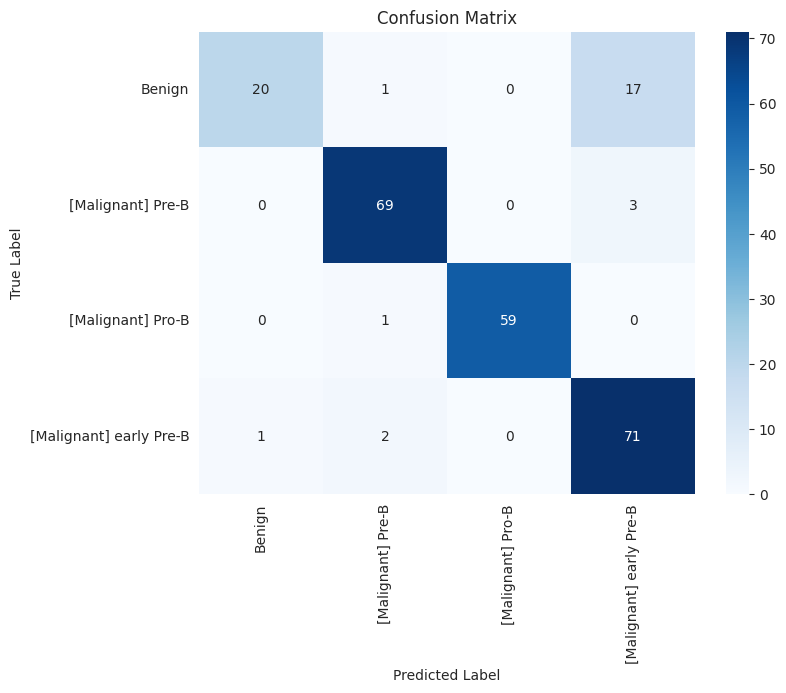

In [ ]:
# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

Takeaways:
1. Evaluation of Hashing Impact: To assess the effect of hashing, **I replicated the model, maintained the same data split, and applied consistent image normalization across all experiments.**
2. Performance Without Hashing: **The results indicated that omitting the hash algorithm led to a slight increase in performance.**
3. Classification Challenges: Similar to the results with hashing applied, the model occasionally struggles to differentiate between benign and early Pre-B categories. **Notably, there is a significant increase in benign cases being misclassified as early Pre-B when hashing is not used.**

##Support Vector Machines (SVM)

The following results were obtained by training the **SVM model using various performance-enhancing methods, including feature scaling, PCA, SMOTE, and GridSearch.**

In [ ]:
# Load the data again ensuring it's the original data
# Define image

IMG_SIZE = (150, 150)

image_paths = []
labels = []

data_path = "dataset/Blood cell Cancer [ALL]"
for subfolder in os.listdir(data_path):
    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue

    for image_filename in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_filename)
        image_paths.append(image_path)
        labels.append(subfolder)

# Convert labels to numerical format
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# Load and preprocess images
features = []
for img_path in image_paths:
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)  # Read image in color
    img = cv2.resize(img, IMG_SIZE)  # Resize to a fixed size
    img = img.flatten()  # Convert image to 1D feature vector
    features.append(img)

features = np.array(features)  # Convert to NumPy array
labels_encoded = np.array(labels_encoded)  # Convert labels to NumPy array

**Feature Scaling - Standardization**

I conducted experiments using both standard scaling and MinMax scaling methods, **but observed no significant difference in performance.**

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# Use StandardScaler
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# For normalization
# scaler = MinMaxScaler()
# features_normalized = scaler.fit_transform(features)

**Apply PCA to reduce dimensionality**

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Dimensionality Reduction (PCA)
pca = PCA(n_components=100)  # Reduce to 100 principal components
features_pca = pca.fit_transform(features_scaled)

**Apply SMOTE to balance classes**

**I noticed that the number of benign samples in the dataset is relatively small**, which may explain why the model struggled to capture the characteristics of the benign category and often misclassified it as early-Pre B. To address this issue, I applied SMOTE to mitigate the impact of the class imbalance.

In [ ]:
from imblearn.over_sampling import SMOTE

# Handle Class Imbalance using SMOTE
smote = SMOTE()
features_resampled, labels_resampled = smote.fit_resample(features_pca, labels_encoded)

**Split the data**

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(features_resampled, labels_resampled, test_size=0.2, random_state=42)

**Use GridSeach to find the best parameter**

In [ ]:
from sklearn.model_selection import GridSearchCV

# Hyperparameter Tuning using GridSearchCV
param_grid = {'C': [0.1, 1, 10], 'gamma': [0.1, 1, 10]}
grid_search = GridSearchCV(SVC(), param_grid, cv=5)  # 5-fold cross-validation
grid_search.fit(X_train, y_train)

print(f"Best parameters from GridSearchCV: {grid_search.best_params_}")

# Train SVM model using the best parameters
best_svc = grid_search.best_estimator_
best_svc.fit(X_train, y_train)

Best parameters from GridSearchCV: {'C': 10, 'gamma': 0.1}


SVC(C=10, gamma=0.1)

In [ ]:
# Evaluate on test data
y_pred = best_svc.predict(X_test)

# Evaluation Metrics without weighted average
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')  # Weighted to handle multi-class
recall = recall_score(y_test, y_pred, average='weighted')        # Weighted to handle multi-class
f1 = f1_score(y_test, y_pred, average='weighted')                # Weighted to handle multi-class

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)

Accuracy: 0.29591836734693877
Precision: 0.8211252068394926
Recall: 0.29591836734693877
F1-Score: 0.19948910942196046


In [ ]:
import joblib

# Save the trained SVM model
joblib.dump(best_svc, 'svm_model.pkl')
print("Model saved successfully!")

Model saved successfully!


Takeaways:
1. SVM Performance Comparison: **When compared to the CNN model, the performance of the SVM model significantly dropped.** This suggests that either hashing needs to be applied to the SVM model as well, or that SVM may not be well-suited for this particular task.
2. Precision vs. Recall: The model exhibits a relatively high precision but a low recall, resulting in a low F1-Score. This indicates that the model is more cautious, effectively minimizing false positives, but struggles to identify true positives, leading to a high number of false negatives.
3. Next Steps: Moving forward, **I plan to experiment with allowing the CNN to first learn features from the images, followed by the application of the hashing algorithm.** The objective is to **determine whether reversing the order of operations can enhance overall performance** when combined with an SVM model.

## CNN Extract Features - Hashing - SVM Model

In [ ]:
import os
import numpy as np
import cv2
import imagehash
from PIL import Image
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Define image size
IMG_SIZE = (150, 150)

# Load image paths and labels
image_paths = []
labels = []

data_path = "dataset/Blood cell Cancer [ALL]"
for subfolder in os.listdir(data_path):
    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue

    for image_filename in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_filename)
        image_paths.append(image_path)
        labels.append(subfolder)

# Convert labels to numerical format
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# Perceptual Hash Function
def get_image_hash(image_path):
    try:
        img = Image.open(image_path).convert("L")  # Convert to grayscale
        hash_value = imagehash.phash(img)  # Compute perceptual hash
        return np.array(hash_value.hash, dtype=np.uint8).flatten()  # Convert to NumPy array
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return None

# Compute perceptual hashes for all images
features = []
for img_path in image_paths:
    hash_vector = get_image_hash(img_path)
    if hash_vector is not None:
        features.append(hash_vector)

features = np.array(features)  # Convert to NumPy array
labels_encoded = np.array(labels_encoded)  # Convert labels to NumPy array

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(features, labels_encoded, test_size=0.2, random_state=42)

# Train an SVM Classifier
svm_model = SVC(kernel='rbf')  # You can also try 'rbf' kernel
svm_model.fit(X_train, y_train)

# Make Predictions
y_pred = svm_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')  # Weighted to handle multi-class
recall = recall_score(y_test, y_pred, average='weighted')        # Weighted to handle multi-class
f1 = f1_score(y_test, y_pred, average='weighted')                # Weighted to handle multi-class

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)

Accuracy: 0.423728813559322
Precision: 0.3622125111192439
Recall: 0.423728813559322
F1-Score: 0.3893547722260043


In [ ]:
# Print Precision, Recall, F1-Score
print("\nClassification Report:")
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))


Classification Report:
                         precision    recall  f1-score   support

                 Benign       0.00      0.00      0.00       104
      [Malignant] Pre-B       0.42      0.55      0.48       184
      [Malignant] Pro-B       0.53      0.54      0.53       187
[Malignant] early Pre-B       0.34      0.42      0.38       174

               accuracy                           0.42       649
              macro avg       0.32      0.38      0.35       649
           weighted avg       0.36      0.42      0.39       649



In [ ]:
import joblib

# Save the SVM model to a file
joblib.dump(svm_model, 'svm_model_hashing.pkl')

['svm_model_hashing.pkl']

Takeaways:
1. The model, which applies CNN for feature extraction, followed by perceptual hashing and SVM training, **demonstrates performance similar to the previous SVM-based approach.**
2. However, **the significant drop in precision** suggests that the model is making random predictions rather than effectively distinguishing between classes.
3. Next Steps: I will implement a Random Forest model and incorporate techniques such as PCA and data augmentation to evaluate potential performance improvements.

##Random Forest

In [ ]:
# Reload the data

data_path = "dataset/Blood cell Cancer [ALL]"

images = []
labels = []

for subfolder in os.listdir(data_path):
    subfolder_path = os.path.join(data_path, subfolder)
    if not os.path.isdir(subfolder_path):
        continue

    for image_filename in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_filename)
        images.append(image_path)
        labels.append(subfolder)

# Convert to DataFrame
data = pd.DataFrame({'image': images, 'label': labels})
print(len(data)) # Match the original data length = 3242

3242


In [ ]:
# Convert labels to numerical format
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(data['label'])

# Read and process original image data
features = []
for img_path in data['image']:
    img = cv2.imread(img_path)
    img = cv2.resize(img, IMG_SIZE)
    img = img.flatten()  # Convert the image to a 1D feature vector
    features.append(img)

features = np.array(features)

**Apply data augmentation**

Try to apply data augmentation to increase the diversity of training set.

In [ ]:
# **Define ImageDataGenerator for data augmentation**
data_gen = ImageDataGenerator(
    rotation_range=20,  # Rotation range
    width_shift_range=0.2,  # Horizontal shift range
    height_shift_range=0.2,  # Vertical shift range
    shear_range=0.2,  # Shear transformation range
    zoom_range=0.2,  # Zoom transformation range
    horizontal_flip=True,  # Whether to flip horizontally
    fill_mode="nearest"  # Filling mode
)

# **Define augmentation function**
def augment_image(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, IMG_SIZE)
    img = np.expand_dims(img, axis=0)  # Reshape for ImageDataGenerator input
    augmented_img = data_gen.flow(img, batch_size=1).__next__()[0]  # Generate augmented image
    return augmented_img.flatten()  # Convert to 1D feature vector

# **Apply augmentation to each image**
features_augmented = np.array([augment_image(img_path) for img_path in data['image']])

# **Combine original and augmented data**
features_combined = np.vstack((features, features_augmented))  # Stack original and augmented features
labels_combined = np.hstack((labels_encoded, labels_encoded))  # Duplicate labels for augmented images

**Apply PCA to reduce image dimensionality**



Reduce dimensionality after ensuring that principal components are learned from a richer dataset.

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder

features = np.array(features)
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)  # Encode labels numerically

# Print original feature shape before PCA
print("Original feature shape:", features.shape)

# Apply PCA to reduce dimensions
pca = PCA(n_components=100)  # Adjust the number of components as needed
features_pca = pca.fit_transform(features)

Original feature shape: (3242, 67500)


**Print out variance to decide how many components to keep.**

**Aim for maximize variance in PCA.**

In [ ]:
# Print the transformed feature shape after PCA
print("Transformed feature shape after PCA:", features_pca.shape)

# Print the explained variance ratio
print("Explained variance ratio by each PCA component:", pca.explained_variance_ratio_)

# Optionally, print cumulative variance to see how much total variance is captured
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
print("Cumulative explained variance:", cumulative_variance)

Transformed feature shape after PCA: (3242, 100)
Explained variance ratio by each PCA component: [0.14109165 0.02448972 0.01148891 0.00660007 0.00636416 0.0061342
 0.00581092 0.00575734 0.00548945 0.00528904 0.00513959 0.0051223
 0.0049624  0.00483812 0.00481057 0.00468573 0.00464008 0.00458454
 0.00448526 0.00443179 0.0044074  0.00433549 0.00426078 0.00424075
 0.00418621 0.00409506 0.00406601 0.00402646 0.00399933 0.00394168
 0.00392052 0.00386564 0.00384733 0.0038029  0.00377592 0.00374218
 0.00365849 0.00360302 0.00358121 0.00356901 0.00354576 0.00349275
 0.00347186 0.00342403 0.00337234 0.00336686 0.00333136 0.00331455
 0.0033066  0.00328966 0.00322935 0.00319854 0.00317572 0.00317157
 0.00313607 0.00310865 0.0030857  0.00307564 0.0030238  0.00299645
 0.00295966 0.00293287 0.0029136  0.00288877 0.00287741 0.00284059
 0.00282418 0.00280513 0.00277466 0.0027507  0.00273404 0.00272384
 0.00270374 0.00266138 0.00264275 0.00263117 0.00260615 0.00258941
 0.00256957 0.00252312 0.0025023  

**Apply SMOTE to solve classes imbalanced.**

**Check if we have imbalance problem(benign has less samples) + ensure afterwards we have balanced or not oversampled.**

In [ ]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# Check class distribution before SMOTE
print("Class distribution before SMOTE:", Counter(labels_encoded))

# Apply SMOTE
smote = SMOTE(random_state=42)
features_resampled, labels_resampled = smote.fit_resample(features_pca, labels_encoded)

# Check class distribution after SMOTE
print("Class distribution after SMOTE:", Counter(labels_resampled))

Class distribution before SMOTE: Counter({np.int64(3): 979, np.int64(1): 955, np.int64(2): 796, np.int64(0): 512})
Class distribution after SMOTE: Counter({np.int64(2): 979, np.int64(0): 979, np.int64(1): 979, np.int64(3): 979})


**Train Random Forest Model**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import train_test_split

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(features_resampled, labels_resampled, test_size=0.2, random_state=42)

# Train Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Make predictions
y_pred = rf_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')  # Weighted to handle multi-class
recall = recall_score(y_test, y_pred, average='weighted')        # Weighted to handle multi-class
f1 = f1_score(y_test, y_pred, average='weighted')                # Weighted to handle multi-class

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))

Accuracy: 0.8992346938775511
Precision: 0.9010776907620733
Recall: 0.8992346938775511
F1-Score: 0.8989155212546884
Accuracy: 0.8992346938775511
                         precision    recall  f1-score   support

                 Benign       0.89      0.85      0.87       197
      [Malignant] Pre-B       0.93      0.84      0.88       188
      [Malignant] Pro-B       0.95      0.98      0.96       201
[Malignant] early Pre-B       0.83      0.92      0.88       198

               accuracy                           0.90       784
              macro avg       0.90      0.90      0.90       784
           weighted avg       0.90      0.90      0.90       784



In [ ]:
# Save the model to a file
joblib.dump(rf_model, 'random_forest_model.joblib')

['random_forest_model.joblib']

Takeaways:
1. The performance of the model without using hashing is close to that of the CNN model, suggesting that hashing may not significantly contribute to improving classification accuracy in this dataset.
2. The high performance achieved highlights **the importance of data augmentation, PCA, and SMOTE techniques in enhancing model performance.** These preprocessing methods play a crucial role in addressing class imbalance and improving feature representation.